### test audio split function

In [5]:
import librosa
import os
import numpy as np
import pandas as pd
from pathlib import Path

# Robust import of databass package from notebook, regardless of CWD
try:
    from databass.preprocess.audio_split import clear_folder, audio_split_by_note
except ModuleNotFoundError:
    import sys
    sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..')))
    sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..', '..')))
    from databass.preprocess.audio_split import clear_folder, audio_split_by_note

WORKING_DIR = os.environ.get('WORKING_DIR', '.')
# Example usage of audio_split_by_note
clear_folder(f'{WORKING_DIR}/notebooks/Edgar/notes', confirm=True)

audio_file = f'{WORKING_DIR}/notebooks/Edgar/HappyBDay.wav'
result = audio_split_by_note(audio_file, dossier_sortie=Path(f'{WORKING_DIR}/notebooks/Edgar/notes'), confirm_clear=True)

/home/edgar/.pyenv/versions/DataBass/lib/python3.12/site-packages/pydub/utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


/home/edgar/code/Arkyed/08-Project/databass-code/DataBass/notebooks/Edgar/HappyBDay.wav
True
✓ Loading audio file: /home/edgar/code/Arkyed/08-Project/databass-code/DataBass/notebooks/Edgar/HappyBDay.wav (3.06 MB)
✓ Audio loaded successfully - Duration: 18.17s, Sample rate: 44100 Hz
✓ Estimated tempo: 103.36 BPM
✓ Detected 25 note(s) stored in onset_times
✓ Detected note lengths for 25 note(s)
✓ number of note lengths correspond to number of detected onsets
✓ Output folder created/verified: '/home/edgar/code/Arkyed/08-Project/databass-code/DataBass/notebooks/Edgar/notes'
  ✓ Note 001 saved: /home/edgar/code/Arkyed/08-Project/databass-code/DataBass/notebooks/Edgar/notes/note_001.wav (313ms)
  ✓ Note 002 saved: /home/edgar/code/Arkyed/08-Project/databass-code/DataBass/notebooks/Edgar/notes/note_002.wav (290ms)
  ✓ Note 003 saved: /home/edgar/code/Arkyed/08-Project/databass-code/DataBass/notebooks/Edgar/notes/note_003.wav (616ms)
  ✓ Note 004 saved: /home/edgar/code/Arkyed/08-Project/datab

In [6]:
result['tempo']

103.359375

In [7]:
result['note_lengths']

[np.float64(0.31346938775510214),
 np.float64(0.2902494331065759),
 np.float64(0.615328798185941),
 np.float64(0.580498866213152),
 np.float64(0.6037188208616779),
 np.float64(1.2074376417233563),
 np.float64(0.30185941043083897),
 np.float64(0.2902494331065757),
 np.float64(0.6037188208616779),
 np.float64(0.6037188208616779),
 np.float64(0.5921088435374147),
 np.float64(1.2074376417233568),
 np.float64(0.31346938775510225),
 np.float64(0.27863945578231153),
 np.float64(0.6037188208616779),
 np.float64(0.5921088435374156),
 np.float64(0.6037188208616779),
 np.float64(0.6037188208616779),
 np.float64(1.4976870748299316),
 np.float64(0.3831292517006819),
 np.float64(0.37151927437641596),
 np.float64(0.7430385487528355),
 np.float64(0.7662585034013603),
 np.float64(0.7314285714285713),
 np.float64(2.7247619047619036)]

In [8]:
result.keys()

dict_keys(['num_notes_detected', 'num_files_created', 'output_folder', 'onset_times', 'note_lengths', 'success', 'tempo', 'csv_file'])

In [9]:
result['num_notes_detected'] , len(result['onset_times']) , len(result['note_lengths'])

(25, 25, 25)

In [10]:
pd.DataFrame([result['onset_times'],result['note_lengths']])

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,0.008617,0.012245,0.015624,0.022766,0.029501,0.036508,0.050544,0.054036,0.057415,0.064422,...,0.106213,0.113084,0.120091,0.127098,0.144490,0.148934,0.153243,0.161882,0.170771,0.179252
1,0.313469,0.290249,0.615329,0.580499,0.603719,1.207438,0.301859,0.290249,0.603719,0.603719,...,0.592109,0.603719,0.603719,1.497687,0.383129,0.371519,0.743039,0.766259,0.731429,2.724762


Raw onsets: 25 | Filtered: 25 | thr=0.01053


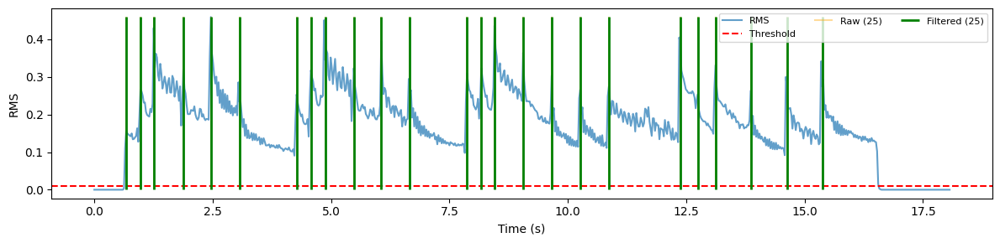

array([ 0.67337868,  0.9752381 ,  1.25387755,  1.88081633,  2.46131519,
        3.06503401,  4.27247166,  4.57433107,  4.87619048,  5.4799093 ,
        6.06040816,  6.66412698,  7.87156463,  8.17342404,  8.45206349,
        9.05578231,  9.65950113, 10.26321995, 10.86693878, 12.37623583,
       12.7477551 , 13.11927438, 13.86231293, 14.62857143, 15.37160998])

In [4]:
# Test RMS-based onset filtering to eliminate spurious detections
import numpy as np
import matplotlib.pyplot as plt

audio_file = f'{WORKING_DIR}/notebooks/Edgar/HappyBDay.wav'
hoplen = 512
def test_rms_onset_filtering(audio_file, hoplen=512):
    # Load and preprocess
    y, sr = librosa.load(audio_file)
    start = int(0.1 * sr)  # Skip first 0.1s of noise
    y = y[start:]

    # Detect raw onsets
    onset_frames = librosa.onset.onset_detect(y=y, sr=sr, hop_length=hoplen)
    onstm = librosa.frames_to_time(onset_frames, sr=sr, hop_length=hoplen)

    # Calculate RMS energy (librosa >= 0.8 uses feature.rms)
    rms = librosa.feature.rms(y=y, frame_length=512, hop_length=hoplen).ravel()
    envtm = librosa.frames_to_time(np.arange(len(rms)), sr=sr, hop_length=hoplen)

    # Estimate noise window (use min 1s if clip is short)
    noise_tail = 3.0
    if envtm[-1] < noise_tail:
        noise_tail = max(1.0, envtm[-1] * 0.25)
    noise_mask = envtm > (envtm[-1] - noise_tail)

    noisemedian = np.percentile(rms[noise_mask], 50)
    sigma = np.percentile(rms[noise_mask], 84.1) - noisemedian
    threshold = noisemedian + 0.01 * sigma

    # Interpolate RMS at onset times for robust comparison
    rms_at_onsets = np.interp(onstm, envtm, rms)
    filtered_onstm = onstm[rms_at_onsets > threshold]

    print(f"Raw onsets: {len(onstm)} | Filtered: {len(filtered_onstm)} | thr={threshold:.5f}")
    # Optional quick visualization (compact)
    fig, ax = plt.subplots(figsize=(12, 3))
    ax.plot(envtm, rms, label='RMS', alpha=0.7)
    ax.axhline(threshold, color='r', ls='--', label=f'Threshold')
    ax.vlines(onstm, 0, rms.max(), colors='orange', alpha=0.4, label=f'Raw ({len(onstm)})')
    ax.vlines(filtered_onstm, 0, rms.max(), colors='green', lw=2, label=f'Filtered ({len(filtered_onstm)})')
    ax.set_xlabel('Time (s)'); ax.set_ylabel('RMS')
    ax.legend(loc='upper right', ncols=3, fontsize=8)
    plt.tight_layout(); plt.show()
    return filtered_onstm

test_rms_onset_filtering(audio_file, hoplen=hoplen)

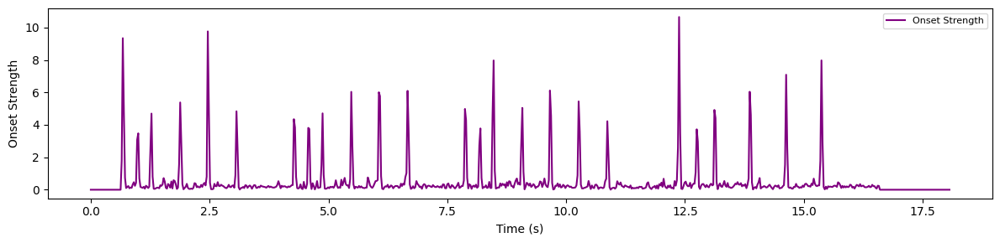

In [28]:
#show the librosa.onset.onset_detect function on the same graph
onset_env = librosa.onset.onset_strength(y=y, sr=sr, hop_length=hoplen)
times = librosa.frames_to_time(np.arange(len(onset_env)), sr=sr, hop_length=hoplen)
fig, ax = plt.subplots(figsize=(12, 3))
ax.plot(times, onset_env, label='Onset Strength', color='purple')
ax.set_xlabel('Time (s)'); ax.set_ylabel('Onset Strength')
ax.legend(loc='upper right', fontsize=8)
plt.tight_layout(); plt.show()

Raw onsets: 27 | Filtered: 15 | thr=0.04158


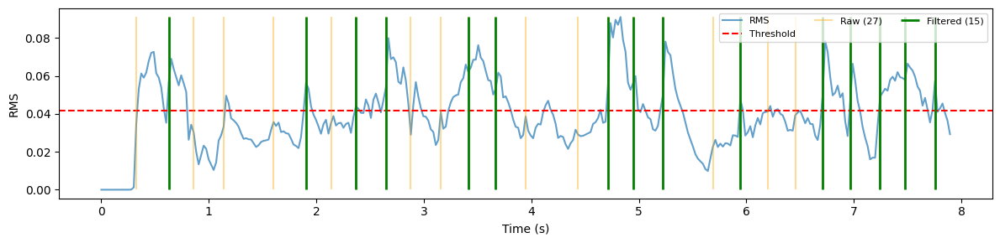

array([0.62693878, 1.90403628, 2.36843537, 2.64707483, 3.41333333,
       3.66875283, 4.71365079, 4.94585034, 5.2244898 , 5.94430839,
       6.71056689, 6.96598639, 7.24462585, 7.4768254 , 7.75546485])

In [ ]:
#let's test both with audio_cut_1.wav
audio_file_2 = f'{WORKING_DIR}/notebooks/Edgar/audio_cut1.wav'

test_rms_onset_filtering(audio_file_2)


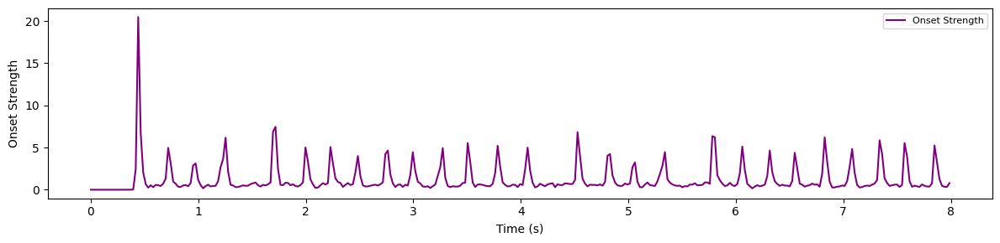

In [30]:
y2,sr2 = librosa.load(audio_file_2)

onset_env = librosa.onset.onset_strength(y=y2, sr=sr2, hop_length=hoplen)
times = librosa.frames_to_time(np.arange(len(onset_env)), sr=sr2, hop_length=hoplen)
fig, ax = plt.subplots(figsize=(12, 3))
ax.plot(times, onset_env, label='Onset Strength', color='purple')
ax.set_xlabel('Time (s)'); ax.set_ylabel('Onset Strength')
ax.legend(loc='upper right', fontsize=8)
plt.tight_layout(); plt.show()

In [2]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from IPython.display import HTML
import numpy as np
import librosa
import os
from pathlib import Path

# Load main audio
WORKING_DIR = os.environ.get('WORKING_DIR', '.')
main_path = Path(WORKING_DIR) / 'notebooks/Edgar/audio_cut1.wav'
if not main_path.exists():
    raise FileNotFoundError(f"Missing main file: {main_path}")

y_main, sr_main = librosa.load(main_path, sr=None)
t_main = np.arange(len(y_main)) / sr_main

# Onsets
hoplen = 512
onset_env = librosa.onset.onset_strength(y=y_main, sr=sr_main, hop_length=hoplen)
env_times = librosa.times_like(onset_env, sr=sr_main, hop_length=hoplen)
onset_frames = librosa.onset.onset_detect(onset_envelope=onset_env, sr=sr_main, units='frames', hop_length=hoplen)
onsets_sec = librosa.frames_to_time(onset_frames, sr=sr_main, hop_length=hoplen)

# If no onsets, create fallback equal splits
if len(onsets_sec) == 0:
    onsets_sec = np.linspace(0, t_main[-1], 5)[1:-1]
    fallback_onsets = True
else:
    fallback_onsets = False

edges = np.concatenate([[0.0], onsets_sec, [t_main[-1]]])
segments = list(zip(edges[:-1], edges[1:]))

# Load split notes produced by audio_split_by_note (expected in notebooks/Edgar/notes)
notes_dir = Path(WORKING_DIR) / 'notebooks/Edgar/notes'
split_files = sorted(notes_dir.glob('*.wav'))
split_traces = []
split_vrects = []
if split_files:
    current_start = 0.0
    for i, f in enumerate(split_files):
        y_s, sr_s = librosa.load(f, sr=None)
        dur = len(y_s) / sr_s if len(y_s) > 0 else 0.0
        t_s = current_start + np.arange(len(y_s)) / sr_s
        # vertical offset so waveforms don't overlap
        offset = i * 0.6
        y_plot = (y_s / (np.max(np.abs(y_s)) + 1e-9)) * 0.5 + offset if len(y_s) > 0 else np.array([])
        split_traces.append({
            'x': t_s.tolist(),
            'y': y_plot.tolist(),
            'name': f.name,
            'offset': offset,
            'start': current_start,
            'end': current_start + dur
        })
        split_vrects.append((current_start, current_start + dur))
        current_start += dur
else:
    split_traces = []
    split_vrects = segments  # show model-based segments

# Build figure
fig = make_subplots(
    rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.08,
    subplot_titles=(
        'Waveform (time domain)',
        'Onset strength + detected onsets',
        'Split notes aligned in time'
    )
)

# 1) Waveform
fig.add_trace(go.Scatter(x=t_main, y=y_main, mode='lines', name='waveform', line=dict(color='royalblue')), row=1, col=1)

# 2) Onset envelope + onsets
fig.add_trace(go.Scatter(x=env_times, y=onset_env, mode='lines', name='onset_strength', line=dict(color='darkorange')), row=2, col=1)
fig.add_trace(go.Scatter(x=onsets_sec, y=np.interp(onsets_sec, env_times, onset_env, left=onset_env.min(), right=onset_env.max()),
                        mode='markers', name='detected_onsets' if not fallback_onsets else 'fallback_onsets',
                        marker=dict(color='green', size=8, symbol='x')), row=2, col=1)

# 3) Split notes panel
for i, tr in enumerate(split_traces):
    fig.add_trace(go.Scatter(x=tr['x'], y=tr['y'], mode='lines', name=tr['name']), row=3, col=1)
for i, (s, e) in enumerate(split_vrects):
    color = 'rgba(99,110,250,0.20)' if i % 2 == 0 else 'rgba(239,85,59,0.20)'
    fig.add_vrect(x0=s, x1=e, fillcolor=color, opacity=0.25, line_width=0, row=3, col=1)

fig.update_layout(
    height=950,
    template='plotly_white',
    title='audio_cut1: waveform, onsets, and aligned split notes',
    legend=dict(orientation='h', y=1.08),
    margin=dict(t=80, b=60, l=60, r=20)
)
fig.update_xaxes(title_text='Time (s)', row=3, col=1)
fig.update_yaxes(title_text='Amplitude', row=1, col=1)
fig.update_yaxes(title_text='Onset strength', row=2, col=1)
fig.update_yaxes(title_text='Note slices (stacked)', row=3, col=1, showticklabels=False)

HTML(fig.to_html(full_html=False, include_plotlyjs='cdn'))


In [3]:
"""
Visualization script for showing overlap regions in audio splits.
Run this in the notebook as:
  exec(open('overlap_viz.py').read())
"""
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from IPython.display import HTML
import numpy as np
import librosa
from pathlib import Path
import os

# Load and prepare data
WORKING_DIR = os.environ.get('WORKING_DIR', '.')
main_path = Path(WORKING_DIR) / 'notebooks/Edgar/audio_cut1.wav'
notes_dir = Path(WORKING_DIR) / 'notebooks/Edgar/notes'

y_main, sr_main = librosa.load(main_path, sr=None)
t_main = np.arange(len(y_main)) / sr_main

# Get onsets
hoplen = 512
onset_env = librosa.onset.onset_strength(y=y_main, sr=sr_main, hop_length=hoplen)
env_times = librosa.times_like(onset_env, sr=sr_main, hop_length=hoplen)
onset_frames = librosa.onset.onset_detect(onset_envelope=onset_env, sr=sr_main, units='frames', hop_length=hoplen)
onsets_sec = librosa.frames_to_time(onset_frames, sr=sr_main, hop_length=hoplen)

if len(onsets_sec) == 0:
    onsets_sec = np.linspace(0, t_main[-1], 5)[1:-1]

# Build figure with 3 subplots
fig = make_subplots(
    rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.08,
    subplot_titles=(
        'Original waveform',
        'Onsets detected',
        'Split notes with overlaps (each note spans onset→next_onset)'
    )
)

# 1) Original waveform
fig.add_trace(go.Scatter(x=t_main, y=y_main, mode='lines', name='audio_cut1',
                         line=dict(color='royalblue', width=1)), row=1, col=1)

# 2) Onset strength + markers
fig.add_trace(go.Scatter(x=env_times, y=onset_env, mode='lines', name='onset_strength',
                         line=dict(color='darkorange')), row=2, col=1)
fig.add_trace(go.Scatter(x=onsets_sec, y=np.interp(onsets_sec, env_times, onset_env,
                         left=onset_env.min(), right=onset_env.max()),
                         mode='markers', name='onsets', marker=dict(color='green', size=8, symbol='x')), row=2, col=1)

# 3) Split notes with color-coded overlap regions
split_files = sorted(notes_dir.glob('*.wav'))
colors = ['rgb(99,110,250)', 'rgb(239,85,59)', 'rgb(0,204,150)', 'rgb(171,99,250)', 'rgb(255,161,90)']

# Recreate note boundaries (onset[i] to onset[i+1])
edges = np.concatenate([[0.0], onsets_sec, [t_main[-1]]])
for i in range(len(edges) - 1):
    start, end = edges[i], edges[i + 1]
    color = colors[i % len(colors)]

    # Colored span for each note region
    fig.add_vrect(x0=start, x1=end, fillcolor=color, opacity=0.15,
                  line=dict(color=color, width=1), row=3, col=1)

    # Load and plot actual split audio if it exists
    if i < len(split_files):
        y_split, sr_split = librosa.load(split_files[i], sr=None)
        t_split = start + np.arange(len(y_split)) / sr_split
        # Normalize and offset for visibility
        y_split_norm = (y_split / (np.max(np.abs(y_split)) + 1e-9)) * 0.4 + (i % 5) * 0.25
        fig.add_trace(go.Scatter(x=t_split, y=y_split_norm, mode='lines',
                                name=f'note_{i+1:03d}', line=dict(color=color, width=1.5)), row=3, col=1)

# Onset markers on bottom plot
fig.add_trace(go.Scatter(x=onsets_sec, y=[0]*len(onsets_sec), mode='markers',
                         name='onset positions', marker=dict(color='black', size=6, symbol='line-ns')), row=3, col=1)

fig.update_layout(
    height=1000,
    template='plotly_white',
    title='Split notes show overlaps: each note spans from its onset to the next onset (explains 2.18× duration)',
    legend=dict(orientation='v', y=0.5, x=1.02),
    margin=dict(t=80, b=60, l=60, r=150),
    hovermode='x unified'
)

fig.update_xaxes(title_text='Time (s)', row=3, col=1)
fig.update_yaxes(title_text='Amplitude', row=1, col=1)
fig.update_yaxes(title_text='Onset strength', row=2, col=1)
fig.update_yaxes(title_text='Note extracts (stacked, color=region)', row=3, col=1)

display(HTML(fig.to_html(full_html=False, include_plotlyjs='cdn')))

In [9]:
import plotly.graph_objects as go
from databass.models.conv2D import create_model

model = create_model(input_shape=(256, 256, 1), num_classes=28)

# Extract layer info
layers_info = []
for layer in model.layers:
    config = layer.get_config()
    layers_info.append({
        'name': layer.name,
        'class': layer.__class__.__name__,
        'output_shape': str(layer.output_shape)
    })

# Display as table
import pandas as pd
df = pd.DataFrame(layers_info)
print(df.to_string())

ImportError: attempted relative import with no known parent package